In [ ]:
# Author: Vanshika Gupta
# Jointly with: Prof Chrysafis Vogiatzis 

# Problem: Identify Clusters

## Table of contents

1. [Creating Final Graph](#finalGraph)
2. [Get Optimal Number of Clusters](#nClusters)
3. [Iterative Bipartitioning](#Iterative_Bipartitioning)
4. [Girvan Newman Method](#girvan)
5. [Modularity Maximization](#modularity)

In [1]:
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import operator
from itertools import combinations

#### Creating Final Graph G <a name="finalGraph">

Initial Graph:

Graph after removing nodes with degree < 10 iteratively :



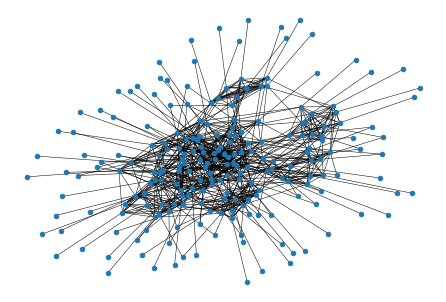

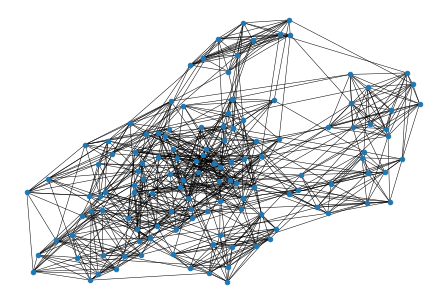

In [2]:
# Read the graph
G1=nx.read_edgelist('games.csv', data=False, delimiter=',')
G = G1.copy()

# Draw initial Graph
print("Initial Graph:\n")
pos=nx.spring_layout(G)
plt.figure(1)
fig1 = nx.draw(G,pos,node_size=20,width=0.5) 
plt.draw()

# remove nodes with degree < 10 iteratively
while True:
    k = 0
    for i in G1.nodes():
        try:
            if(G.degree[i]<10):
                G.remove_node(i)
                k = k + 1
        except:
            pass
    if(k==0):
        break 

# Print final graph
print("Graph after removing nodes with degree < 10 iteratively :\n")
plt.figure(2)
fig2 = nx.draw(G,pos,node_size=20,width=0.5) 
plt.draw()

#### Define some functions

In [3]:
def minConductance(G,sortedNodes):
    c=[]
    c1 = []
    current = []
    minConductance = 10
    for i in sortedNodes[:-1]:
        currentNode = i[0]
        current.append(currentNode)
        conductance = nx.conductance(G, current)
        [minConductance, c] = [conductance, current.copy()] if (conductance < minConductance) else [minConductance,c]
    #print("Partition: ", c, "\nMinimum Conductance: ", minConductance)
    for i in G.nodes():
        if i in c:
            pass
        else:
            c1.append(i)
    return [c, c1]

def getEigens(L):
    eigvalues,eigvectors=np.linalg.eig(L.A)
    idx = eigvalues.argsort()
    return np.around(eigvalues[idx],2), np.around(eigvectors[:,idx],3)

def getSortedNodes(G):
    eigen=nx.fiedler_vector(G)
    counter=0
    partition={}
    for i in G.nodes():
        partition[i]=eigen[counter]
        counter+=1
    sortedNodes=sorted(partition.items(), key=operator.itemgetter(1))
    return sortedNodes
    
def getEigenValue(G):
    L=nx.laplacian_matrix(G)
    eigs,eigvectors=np.linalg.eig(L.A)
    eigs,eigvectors=getEigens(L)
    return eigs[1]

def modularity(G, communities):
    Q=0
    for c in communities:
        mysubgraph=G.subgraph(c)
        sumDegree=0
        for i in c:
            sumDegree+=G.degree(i)
            print(mysubgraph.number_of_edges(), G.degree(i), sumDegree, G.number_of_edges())
        Q+=mysubgraph.number_of_edges()/G.number_of_edges()-(sumDegree/(2*G.number_of_edges()))**2
        
    print(Q)
    return Q

colors = ['blue', 'red', 'green', 'yellow', 'orange', 'purple', 'grey', 'black', 'brown', 'pink']

#### Checking optimal number of clusters <a name="nClusters">

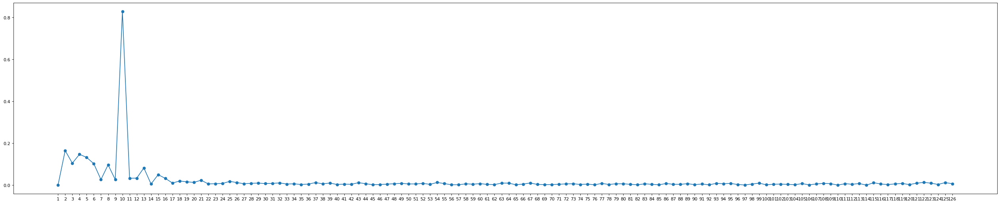

In [4]:
L=nx.laplacian_matrix(G)
eigs,eigvectors=np.linalg.eig(L.A)
eigs,eigvectors=getEigens(L)
jumps=[]
for i in range(1,len(eigs)):
    if eigs[i-1]==0:
        jumps.append(0)
    else:
        jumps.append((eigs[i]-eigs[i-1])/eigs[i-1])

x = range(1,len(eigs))
plt.figure(figsize=(40, 8), dpi=80)
plt.xticks(x)
plotting=plt.plot(x,jumps, '-o')

#### a) Iterative Bipartitioning <a name="Iterative_Bipartitioning"></a>

Number of Clusters:  10
['Wyoming', 'UNLV', 'San José State', 'Boise State', 'Utah State', 'Colorado State', 'Air Force', 'Nevada', 'Fresno State', 'San Diego State', "Hawai'i", 'BYU']
['Oregon State', 'Colorado', 'Arizona State', 'Washington State', 'UCLA', 'Arizona', 'Stanford', 'Oregon', 'Utah', 'USC', 'Washington', 'California']
['Maryland', 'Rutgers', 'Minnesota', 'Purdue', 'Michigan', 'Northwestern', 'Penn State', 'Indiana', 'Ohio State', 'Iowa', 'Michigan State', 'Nebraska', 'Illinois', 'Wisconsin']
['Bowling Green', 'Western Michigan', 'Kent State', 'Miami (OH)', 'Akron', 'Buffalo', 'Eastern Michigan', 'Central Michigan', 'Northern Illinois', 'Toledo', 'Ohio', 'Ball State']
['Pittsburgh', 'Syracuse', 'Boston College', 'Virginia Tech', 'Wake Forest', 'NC State', 'Virginia', 'Florida State', 'North Carolina', 'Duke', 'Louisville', 'Georgia Tech', 'Miami', 'Notre Dame', 'Clemson']
['Florida', 'South Carolina', 'Georgia', 'Vanderbilt', 'Tennessee', 'Texas A&M', 'Auburn', 'Alabama',

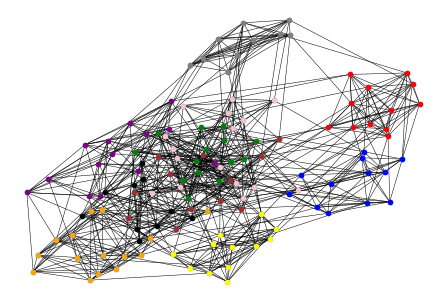

In [5]:
# Peform Iterative Bipartitioning
k = 1
G1 = G.copy()
graphs = [G1.copy()]
partitions = [G1.nodes()]

while k<10:

    # Choose subgraph with lowest eigenvalue corresponfing to the fiedler vector
    min_eig = 100
    min_idx = 0
    for i in range(len(partitions)):
        eig_temp = getEigenValue(graphs[i])
        if(eig_temp < min_eig):
            min_eig = eig_temp
            min_idx = i
    
    G1 = graphs[min_idx]
    sortedNodes = getSortedNodes(G1)
    [p1, p2] = minConductance(G1,sortedNodes)
    k = k + 1
    
    partitions.append(p1)
    partitions.append(p2)
    del partitions[min_idx]
    
    graphs.append(graphs[min_idx].subgraph(p1))
    graphs.append(graphs[min_idx].subgraph(p2))
    del graphs[min_idx]

# Print the partitions
print("Number of Clusters: ", len(partitions))
for i in partitions:
    print(i)
    
# Draw Partitioned Graph
nx.draw(G,pos,node_size=20,width=0.5)
for i in range(k):
    nx.draw_networkx_nodes(G,pos,nodelist=partitions[i],node_color=colors[i],node_size=20)

#### b) Girvan Newman Method <a name="girvan">

Number of Clusters:  10
['Arizona State', 'Utah', 'UCLA', 'Oregon State', 'USC', 'Arizona', 'Stanford', 'California', 'Colorado', 'Washington', 'Oregon', 'Washington State']
['Kansas State', 'Texas Tech', 'Baylor', 'West Virginia', 'Oklahoma State', 'Texas', 'Oklahoma', 'Iowa State', 'Kansas', 'TCU']
['San Diego State', 'Wyoming', 'Air Force', 'Fresno State', 'Boise State', 'Utah State', 'San José State', 'Colorado State', "Hawai'i", 'Nevada', 'UNLV', 'BYU']
['Notre Dame', 'Clemson', 'Florida State', 'Boston College', 'NC State', 'Syracuse', 'Virginia Tech', 'North Carolina', 'Louisville', 'Virginia', 'Georgia Tech', 'Duke', 'Miami', 'Pittsburgh', 'Wake Forest']
['Florida International', 'Army', 'Louisiana Tech', 'Marshall', 'UMass', 'Florida Atlantic', 'Western Kentucky', 'UAB', 'Old Dominion', 'Charlotte', 'Southern Mississippi', 'Middle Tennessee', 'North Texas', 'UTEP', 'Rice', 'UT San Antonio']
['South Florida', 'Houston', 'East Carolina', 'Temple', 'Tulsa', 'Navy', 'Tulane', 'Mem

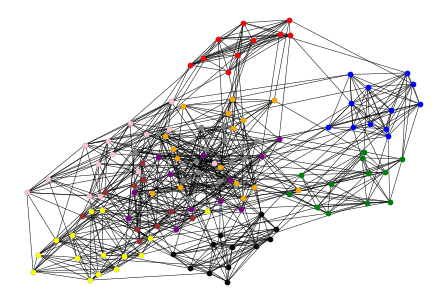

In [6]:
G1 = G.copy()
removeEdges=[]
k = 1
graphs = [G1.copy()]
partitions = [G1.nodes()]

while k<10:
    
    # Choose subgraph with highest number of nodes to be broken
    min_idx = 0
    max_nodes = 0
    for i in range(len(partitions)):
        if(max_nodes < graphs[i].number_of_nodes()):
            max_nodes = graphs[i].number_of_nodes()
            min_idx = i
    
    G1 = graphs[min_idx]
    while nx.is_connected(G1):
        ebet=nx.edge_betweenness_centrality(G1)
        maxEdge=max(ebet, key=ebet.get)
        if maxEdge in G1.edges():
            G1.remove_edge(maxEdge[0],maxEdge[1])
            removeEdges.append((maxEdge[0],maxEdge[1]))
        else:
            G1.remove_edge(maxEdge[1],maxEdge[0])
            removeEdges.append((maxEdge[1],maxEdge[0]))
            
    
    k = k + 1
    
    S = [G1.subgraph(c).copy() for c in nx.connected_components(G1)]
    
    partitions.append(list(S[0].nodes()))
    partitions.append(list(S[1].nodes()))
    del partitions[min_idx]
    
    graphs.append(S[0])
    graphs.append(S[1])
    del graphs[min_idx]

# Print the partitions
print("Number of Clusters: ", len(partitions))
for i in partitions:
    print(i)
    
# Draw Partitioned Graph
nx.draw(G,pos,node_size=20,width=0.5)
for i in range(k):
    nx.draw_networkx_nodes(G,pos,nodelist=partitions[i],node_color=colors[i],node_size=20)

#### Modularity Maximization or Louvain clustering <a name="modularity">

[['Florida'], ['Miami'], ['Kentucky'], ['Tennessee'], ['Auburn'], ['LSU'], ['South Carolina'], ['Georgia'], ['Vanderbilt'], ['Missouri'], ['Florida State'], ['North Carolina'], ['Central Michigan'], ['Virginia Tech'], ['Virginia'], ['Georgia Tech'], ['Pittsburgh'], ['Louisville'], ['Florida International'], ['Duke'], ["Hawai'i"], ['Arizona'], ['Oregon State'], ['Washington'], ['Nevada'], ['Boise State'], ['Air Force'], ['Fresno State'], ['San José State'], ['UNLV'], ['San Diego State'], ['Army'], ['Texas Tech'], ['UCLA'], ['Colorado'], ['USC'], ['Stanford'], ['Oregon'], ['Utah'], ['Arizona State'], ['Bowling Green'], ['Kansas State'], ['Louisiana Tech'], ['Kent State'], ['Notre Dame'], ['Toledo'], ['Western Michigan'], ['Akron'], ['Miami (OH)'], ['Ohio'], ['Buffalo'], ['Penn State'], ['Temple'], ['Eastern Michigan'], ['Cincinnati'], ['Ohio State'], ['Marshall'], ['UCF'], ['Houston'], ['Tulsa'], ['East Carolina'], ['Connecticut'], ['South Florida'], ['Memphis'], ['Oklahoma'], ['Washingt

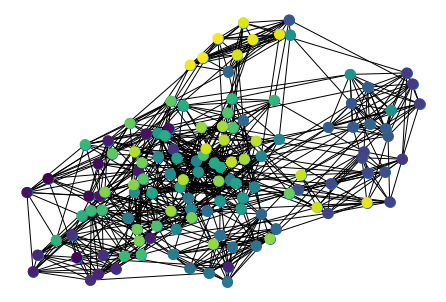

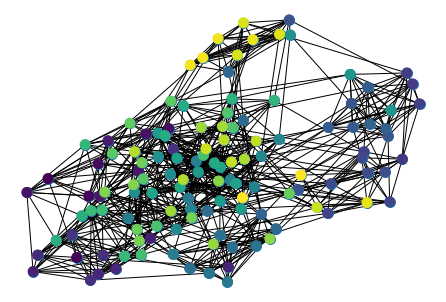

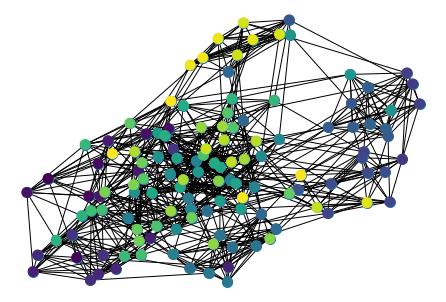

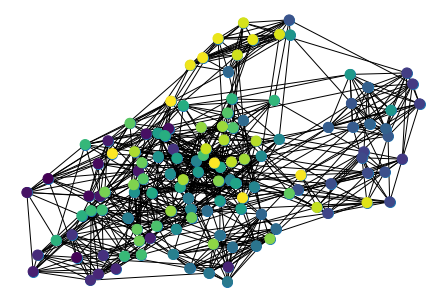

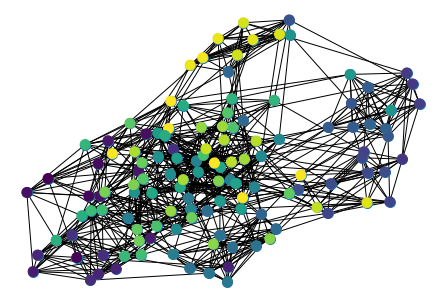

...

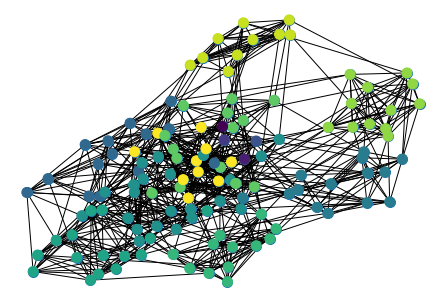

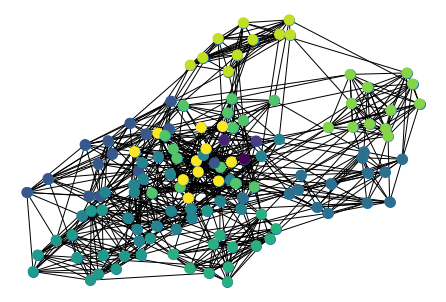

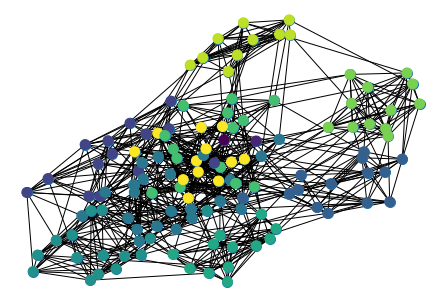

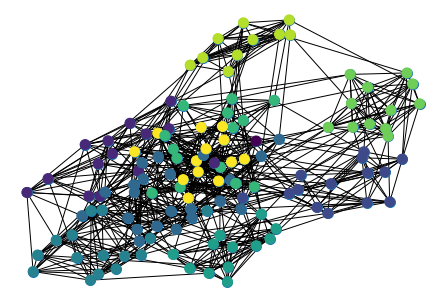

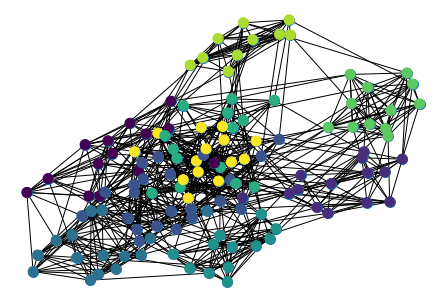

In [7]:
# Every node is its own community initially.
communities=[]
for i in G.nodes():
    communities.append([i])
print(communities)
iteration=0
print(nx.algorithms.community.quality.modularity(G,communities))

maxModularity=1000
prevModularity=nx.algorithms.community.quality.modularity(G, communities)
while maxModularity>0:
    nx.draw(G, pos, node_size=100)
    colors=[]
    for i in G.nodes():
        for j in range(len(communities)):
            if i in communities[j]:
                colors.append(j)
    nodes=nx.draw_networkx_nodes(G, pos, nodelist=G.nodes(), node_color=colors, node_size=100)
    plt.show()
    iteration+=1
    maxModularity=-1
    saveI=-1
    saveJ=-1
    for (i,j) in combinations(communities,2):
        communities2=[]
        for k in communities:
            if k!=i and k!=j:
                communities2.append(k)
        communities2.append(i+j)
        if nx.algorithms.community.quality.modularity(G,communities2)-prevModularity>maxModularity:
            maxModularity=nx.algorithms.community.quality.modularity(G,communities2)-prevModularity
            saveI=i
            saveJ=j
    if maxModularity>0:
        communities2=[]
        for k in communities:
            communities2.append(k)
        communities=[]
        for k in communities2:
            if k!=saveI and k!=saveJ:
                communities.append(k)
        communities.append(saveI+saveJ)
    prevModularity=nx.algorithms.community.quality.modularity(G,communities)
    

In [8]:
print(len(communities))

9
